<a href="https://colab.research.google.com/github/jspaezp/turtles/blob/main/20201114_Turtles.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# install dependencies: 
!pip install progress
!pip install seaborn

!pip install pyyaml==5.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

# install detectron2: (Colab has CUDA 10.1 + torch 1.7)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
import torch
assert torch.__version__.startswith("1.7")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime


1.7.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html


In [2]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

In [3]:
from google.colab import auth
auth.authenticate_user()

In [4]:
%cd /content
!gcloud config set project 	banded-edge-281502
!mkdir turtles_data 
! if [[ ! -f turtles_data/turtles_data.tar ]] ; then gsutil cp gs://20201113-turtles/turtles_data.tar turtles_data/turtles_data.tar ; fi
!tar -xf turtles_data/turtles_data.tar -C turtles_data/

/content
Updated property [core/project].
Copying gs://20201113-turtles/turtles_data.tar...
- [1 files][532.5 MiB/532.5 MiB]                                                
Operation completed over 1 objects/532.5 MiB.                                    


In [5]:
%cd /content
! git clone https://github.com/jspaezp/turtles 
! cd /content/turtles ; git pull
%cd /content/turtles

/content
Cloning into 'turtles'...
remote: Enumerating objects: 49, done.
remote: Counting objects: 100% (49/49), done.
remote: Compressing objects: 100% (35/35), done.
remote: Total 49 (delta 28), reused 33 (delta 12), pack-reused 0
Unpacking objects: 100% (49/49), done.
Already up to date.
/content/turtles


In [6]:
! rm -rf ../turtles_data/split
# ! python data_splitting.py --in_file ../turtles_data/Train.csv --img_dir ../turtles_data/IMAGES_512 --out_dir ../turtles_data/split --fraction 0.8
! python data_splitting.py --in_file ../turtles_data/Train.csv --img_dir ../turtles_data/IMAGES_1024 --out_dir ../turtles_data/split --fraction 0.8

(1326, 5)
<bound method NDFrame.head of       Image_ID  ...         h
0     04FB1B33  ...  0.405671
1     B04E481E  ...  0.293113
2     32655645  ...  0.357350
3     44D4DA7C  ...  0.409722
4     4F36EF72  ...  0.397569
...        ...  ...       ...
1321  7FF4C9A4  ...  0.445891
1322  FD746AE7  ...  0.206887
1323  12316396  ...  0.214988
1324  F6A8DD00  ...  0.366197
1325  780FB6A5  ...  0.399648

[1326 rows x 5 columns]>


In [7]:
# ! python train.py --split_dir ../turtles_data/split --out_dir ../turtles_data/out

In [8]:
from train import *
from t_io import register_datasets

try:
    register_datasets(Path("../turtles_data/split"))
except:
    pass

cfg = config_model(train_dataset="turtle_train", test_dataset="turtle_test")
cfg.SOLVER.MAX_ITER = 1000

trainer = make_trainer(cfg)
trainer.train()

Loading config /usr/local/lib/python3.6/dist-packages/detectron2/model_zoo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


Registered turtle_train to the dataset catalog
Registered turtle_test to the dataset catalog
[11/14 06:07:04 d2.engine.defaults]: Model:
RetinaNet(
  (backbone): FPN(
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelP6P7(
      (p6): Conv2d(2048, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (p7): Conv2d(256, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
 

model_final_971ab9.pkl: 228MB [00:22, 10.3MB/s]                           
Skip loading parameter 'head.cls_score.weight' to the model due to incompatible shapes: (720, 256, 3, 3) in the checkpoint but (9, 256, 3, 3) in the model! You might want to double check if this is expected.
Skip loading parameter 'head.cls_score.bias' to the model due to incompatible shapes: (720,) in the checkpoint but (9,) in the model! You might want to double check if this is expected.


[11/14 06:07:43 d2.engine.train_loop]: Starting training from iteration 0
[11/14 06:07:49 d2.utils.events]:  eta: 0:03:21  iter: 19  total_loss: 1.238  loss_cls: 1.013  loss_box_reg: 0.2517  time: 0.2281  data_time: 0.0154  lr: 4.9953e-06  max_mem: 3183M
[11/14 06:07:52 d2.utils.events]:  eta: 0:03:12  iter: 39  total_loss: 1.38  loss_cls: 1.125  loss_box_reg: 0.2613  time: 0.2110  data_time: 0.0058  lr: 9.9902e-06  max_mem: 3183M
[11/14 06:07:57 d2.utils.events]:  eta: 0:03:09  iter: 59  total_loss: 1.399  loss_cls: 1.102  loss_box_reg: 0.2876  time: 0.2111  data_time: 0.0055  lr: 1.4985e-05  max_mem: 3277M
[11/14 06:08:01 d2.utils.events]:  eta: 0:03:09  iter: 79  total_loss: 1.291  loss_cls: 1.078  loss_box_reg: 0.2168  time: 0.2125  data_time: 0.0054  lr: 1.998e-05  max_mem: 3277M
[11/14 06:08:05 d2.utils.events]:  eta: 0:03:01  iter: 99  total_loss: 1.178  loss_cls: 0.9985  loss_box_reg: 0.1634  time: 0.2092  data_time: 0.0063  lr: 2.4975e-05  max_mem: 3277M
[11/14 06:08:09 d2.uti

In [9]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [10]:
from detectron2.engine import DefaultPredictor
from prediction import get_predictor

predictor = get_predictor(cfg)

Loading config /usr/local/lib/python3.6/dist-packages/detectron2/model_zoo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


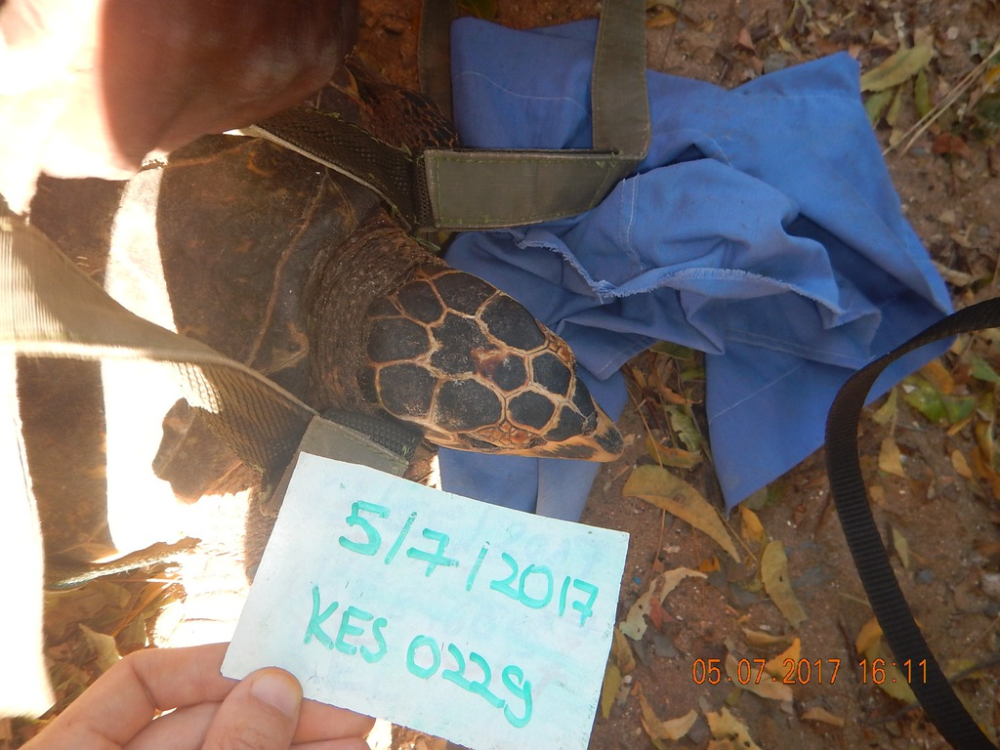

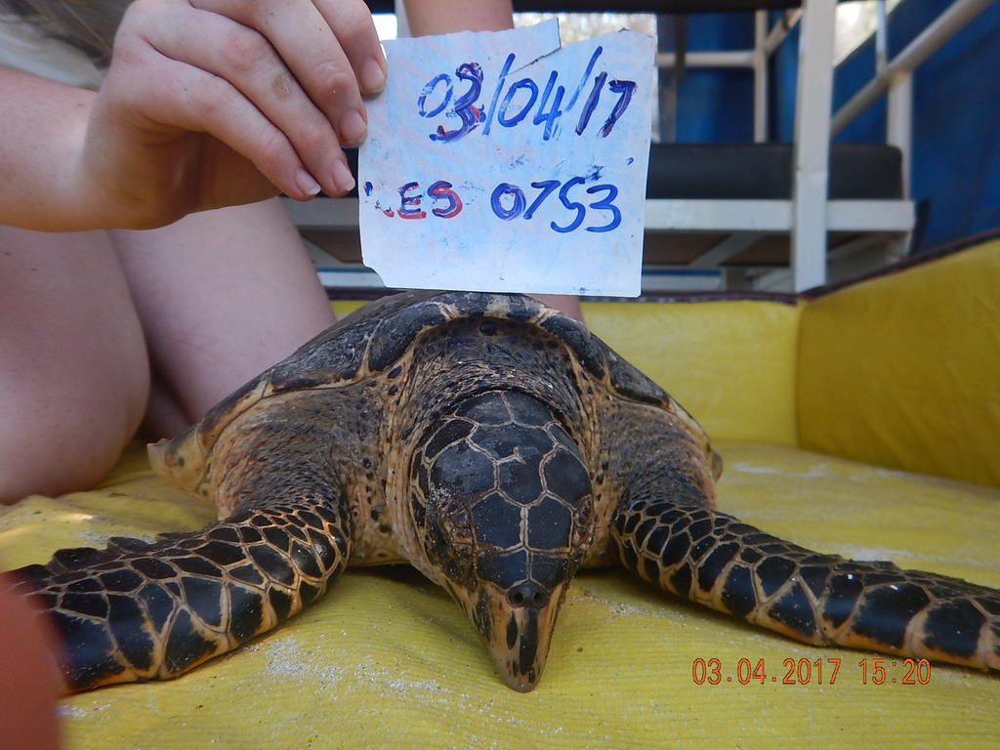

In [11]:
im = cv2.imread("/content/turtles_data/IMAGES_1024/D4086865.JPG")
cv2_imshow(im)

im = cv2.imread("/content/turtles_data/split/test/00C7A530.JPG")
cv2_imshow(im)

In [12]:
outputs = predictor(im)
outputs

{'instances': Instances(num_instances=2, image_height=768, image_width=1024, fields=[pred_boxes: Boxes(tensor([[426.2212, 392.2554, 611.6208, 706.4344],
         [  9.5659, 539.9193, 327.6807, 708.4799]], device='cuda:0')), scores: tensor([0.9966, 0.1160], device='cuda:0'), pred_classes: tensor([0, 0], device='cuda:0')])}

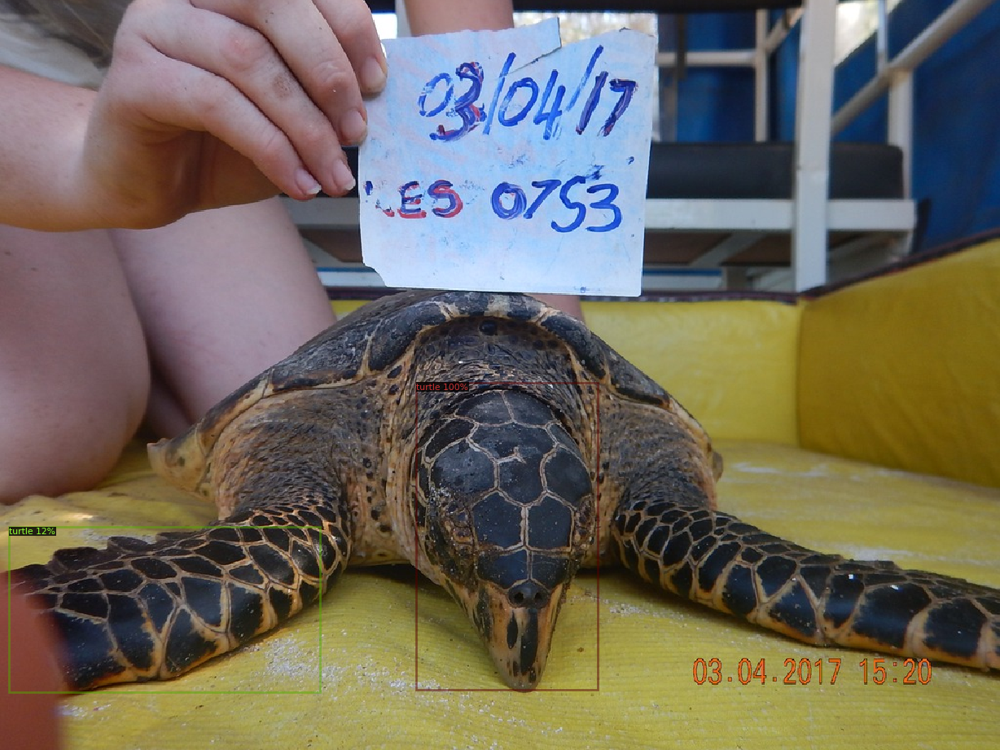

In [13]:
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

In [14]:
from prediction import predict_submission, prediction_to_df
import pandas as pd
from prediction import get_top_hits

In [15]:
from prediction import pandas_iou

in_df = pd.read_csv(str(Path("/content/turtles_data/split/test/entries.csv")))

testset_hit_df = predict_submission(
    Path("/content/turtles_data/split/test/entries.csv"),
    predictor,
    Path("/content/turtles_data/IMAGES_1024"))

print(testset_hit_df)
testset_hit_df = in_df.set_index("Image_ID").join(testset_hit_df.set_index("Image_ID"), rsuffix = "_pred")
testset_hit_df

pandas_iou(testset_hit_df.fillna(0)).mean()


     Image_ID         x         y         w         h     score
0    B38B49E1  0.449306  0.459685  0.141877  0.323163  0.996266
1    64B2A905  0.392664  0.478732  0.197958  0.448869  0.993511
2    C7EC3E54  0.321857  0.520000  0.328686  0.323160  0.988192
3    DF33AA5F  0.124945  0.209111  0.265349  0.403993  0.984340
4    948C2466  0.478256  0.530400  0.196807  0.179930  0.960639
..        ...       ...       ...       ...       ...       ...
261  50F9DBB4  0.387653  0.481320  0.161690  0.268317  0.978704
262  E1644226  0.346564  0.593949  0.418128  0.382202  0.993322
263  AE74771B  0.428042  0.534784  0.451018  0.404723  0.995614
264  788A6AC8  0.520927  0.543344  0.202359  0.261909  0.981481
265  972B86E0  0.547556  0.651930  0.245163  0.327473  0.926257

[266 rows x 6 columns]


0.9191852092474718

In [16]:
in_df = pd.read_csv(str(Path("/content/turtles_data/split/train/entries.csv")))

trainset_hit_df = predict_submission(
    Path("/content/turtles_data/split/train/entries.csv"),
    predictor,
    Path("/content/turtles_data/IMAGES_1024"))

print(trainset_hit_df)
trainset_hit_df = in_df.set_index("Image_ID").join(trainset_hit_df.set_index("Image_ID"), rsuffix = "_pred")
trainset_hit_df


      Image_ID         x         y         w         h     score
0     C3E2D0F0  0.194482  0.193476  0.706866  0.743319  0.990364
1     66FBB2FF  0.399666  0.476610  0.141474  0.168940  0.744743
2     8D4A9B52  0.355579  0.357789  0.295198  0.606716  0.988444
3     F2E4929A  0.445846  0.493332  0.381759  0.436570  0.998817
4     CFAD2322  0.474921  0.369066  0.248336  0.280546  0.946823
...        ...       ...       ...       ...       ...       ...
1055  E6B587E0  0.482911  0.427240  0.176634  0.298893  0.996170
1056  45F07021  0.446465  0.057660  0.393810  0.462183  0.989994
1057  BB4B6E51  0.578458  0.532695  0.260418  0.244544  0.966310
1058  46BD51F7  0.341634  0.436166  0.272659  0.562887  0.999704
1059  578A17FB  0.495382  0.536389  0.168600  0.225775  0.972914

[1060 rows x 6 columns]


,Unnamed: 0,x,y,w,h,x_pred,y_pred,w_pred,h_pred,score
Image_ID,,,,,,,,,,
C3E2D0F0,889,0.170000,0.199333,0.721250,0.730333,0.194482,0.193476,0.706866,0.743319,0.990364
66FBB2FF,467,0.398220,0.474537,0.177300,0.190394,0.399666,0.476610,0.141474,0.168940,0.744743
8D4A9B52,887,0.345616,0.359453,0.307836,0.615050,0.355579,0.357789,0.295198,0.606716,0.988444
F2E4929A,175,0.437934,0.493924,0.390191,0.433738,0.445846,0.493332,0.381759,0.436570,0.998817
CFAD2322,1286,0.480194,0.380282,0.241197,0.252347,0.474921,0.369066,0.248336,0.280546,0.946823
...,...,...,...,...,...,...,...,...,...,...
E6B587E0,606,0.485460,0.433160,0.172309,0.295718,0.482911,0.427240,0.176634,0.298893,0.996170
45F07021,180,0.443142,0.052951,0.398220,0.470775,0.446465,0.057660,0.393810,0.462183,0.989994
BB4B6E51,301,0.568793,0.539641,0.269748,0.255787,0.578458,0.532695,0.260418,0.244544,0.966310


In [17]:

print(pandas_iou(trainset_hit_df).mean())
print(pandas_iou(trainset_hit_df.fillna(0)).mean())


0.9219152737406331
0.9219152737406331


In [18]:

df = predict_submission(
    Path("/content/turtles_data/SampleSubmission.csv"),
    predictor,
    Path("/content/turtles_data/IMAGES_1024"))


In [19]:
df = df.fillna(0)

In [20]:
df.groupby("Image_ID").agg({'score': 'max'})

,score
Image_ID,
003B27CF,0.993320
008876A9,0.853177
00D2330B,0.994593
013999E4,0.983176
016117B7,0.999241
...,...
FE00066C,0.996134
FEB02FBE,0.998477
FEB5B3A0,0.986359


In [21]:
df[df["Image_ID"] == "003B27CF"]

,Image_ID,x,y,w,h,score
230,003B27CF,0.354528,0.555898,0.197829,0.308136,0.99332


In [22]:
df[df["Image_ID"] == "558036F6"]

,Image_ID,x,y,w,h,score
476,558036F6,0.399248,0.207525,0.569697,0.730707,0.939149


In [23]:
bad_preds = df[df['score'] < 0.5]
confident_preds = df[df['score'] > 0.95]

In [24]:
sub_df = pd.read_csv("/content/turtles_data/SampleSubmission.csv")

In [25]:
print(sub_df)
print(df)

     Image_ID  x  y  w  h
0    4863D911  0  0  0  0
1    6DD3ADD5  0  0  0  0
2    E8DC4D6A  0  0  0  0
3    E02ABB6C  0  0  0  0
4    875C19F4  0  0  0  0
..        ... .. .. .. ..
690  1E9E94E9  0  0  0  0
691  0EC294FB  0  0  0  0
692  888F7FF4  0  0  0  0
693  5A63FD0E  0  0  0  0
694  AD30E9B2  0  0  0  0

[695 rows x 5 columns]
     Image_ID         x         y         w         h     score
0    4863D911  0.182005  0.271006  0.582776  0.552433  0.938289
1    6DD3ADD5  0.337568  0.310057  0.366734  0.476510  0.999556
2    E8DC4D6A  0.368665  0.535702  0.431735  0.426678  0.997937
3    E02ABB6C  0.336752  0.543525  0.411135  0.394568  0.997435
4    875C19F4  0.372249  0.468327  0.396288  0.397216  0.995392
..        ...       ...       ...       ...       ...       ...
690  1E9E94E9  0.555303  0.359309  0.106907  0.212893  0.975282
691  0EC294FB  0.524711  0.643606  0.154042  0.339189  0.997283
692  888F7FF4  0.484982  0.492982  0.178363  0.424800  0.992806
693  5A63FD0E  0.452071 

In [26]:
df_out = df.copy()
del df_out['score']

df_out.to_csv("jspp_sub_20201113_4.csv", index = False)

In [27]:
! head jspp_sub_20201113_4.csv
! echo "============"
! head /content/turtles_data/SampleSubmission.csv

Image_ID,x,y,w,h
4863D911,0.1820046,0.27100626,0.5827763,0.552433
6DD3ADD5,0.33756822,0.31005684,0.3667339,0.47650966
E8DC4D6A,0.3686655,0.5357017,0.43173495,0.426678
E02ABB6C,0.33675167,0.5435254,0.41113546,0.39456826
875C19F4,0.37224936,0.46832743,0.39628786,0.39721593
5BEAAECC,0.48164427,0.42375615,0.16195023,0.23468545
51ACD6F6,0.3831667,0.38901785,0.3802726,0.35653874
A79140B3,0.33436567,0.51640785,0.308666,0.31409758
678A0DB3,0.36048046,0.41962358,0.46207651,0.4321241
Image_ID,x,y,w,h
4863D911,0,0,0,0
6DD3ADD5,0,0,0,0
E8DC4D6A,0,0,0,0
E02ABB6C,0,0,0,0
875C19F4,0,0,0,0
5BEAAECC,0,0,0,0
51ACD6F6,0,0,0,0
A79140B3,0,0,0,0
678A0DB3,0,0,0,0


In [28]:
df[df["Image_ID"] == "003B27CF"]

,Image_ID,x,y,w,h,score
230,003B27CF,0.354528,0.555898,0.197829,0.308136,0.99332


In [29]:
bad_preds

,Image_ID,x,y,w,h,score
390,846134F3,0.381628,0.725839,0.130633,0.178609,0.313686
425,41757A1A,0.417126,0.450922,0.140478,0.176120,0.140196


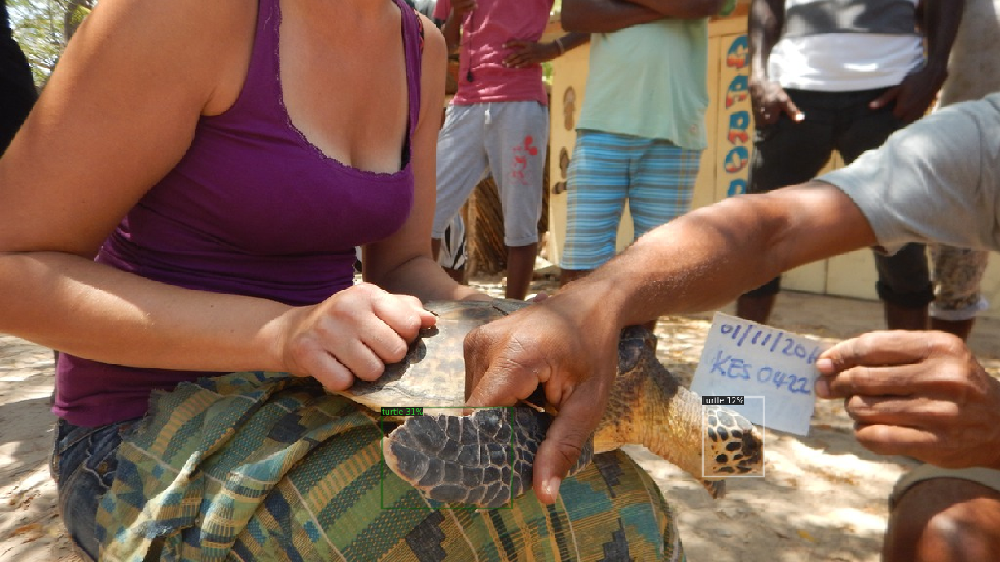

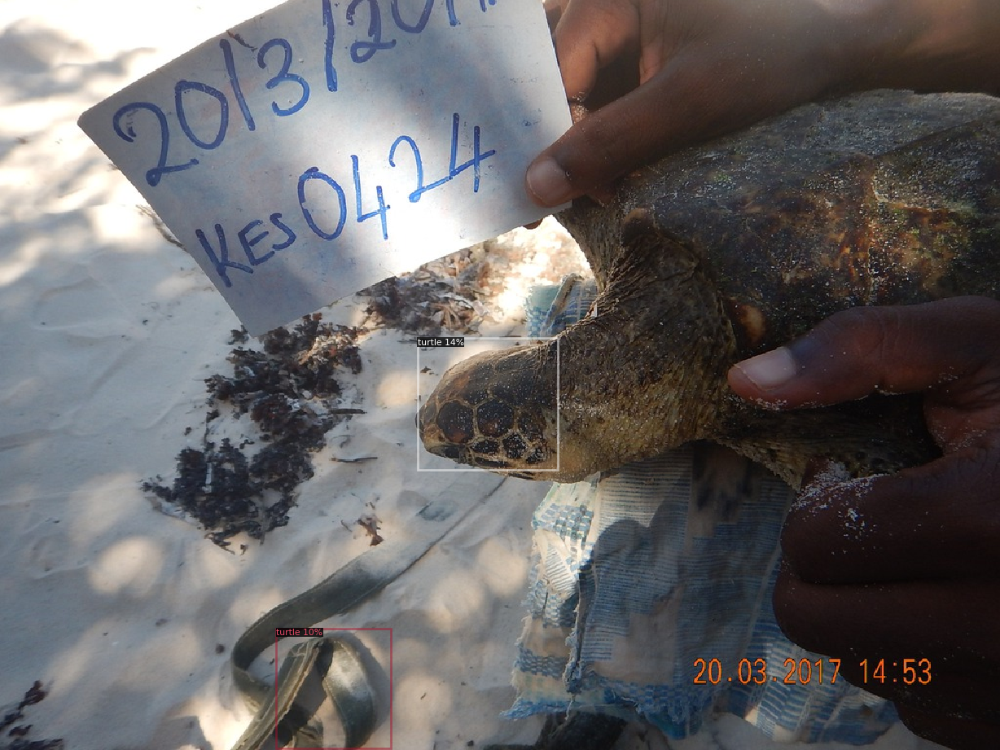

In [30]:

sampled_bad_imgs = random.sample(list(bad_preds["Image_ID"]), min(5, len(bad_preds)))
sampled_good_imgs = random.sample(list(confident_preds["Image_ID"]), min(5, len(confident_preds)))

from visualization import visualize_predictions


for img in sampled_bad_imgs:
    im = cv2.imread(f"/content/turtles_data/IMAGES_1024/{img}.JPG")
    outputs = predictor(im)
    oi = visualize_predictions(im, outputs, cfg)
    cv2_imshow(oi)



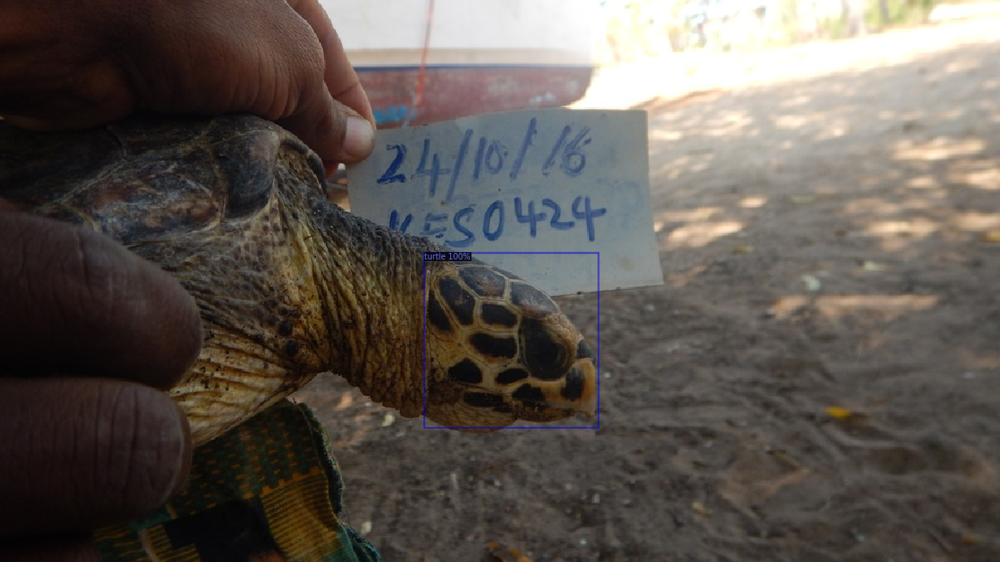

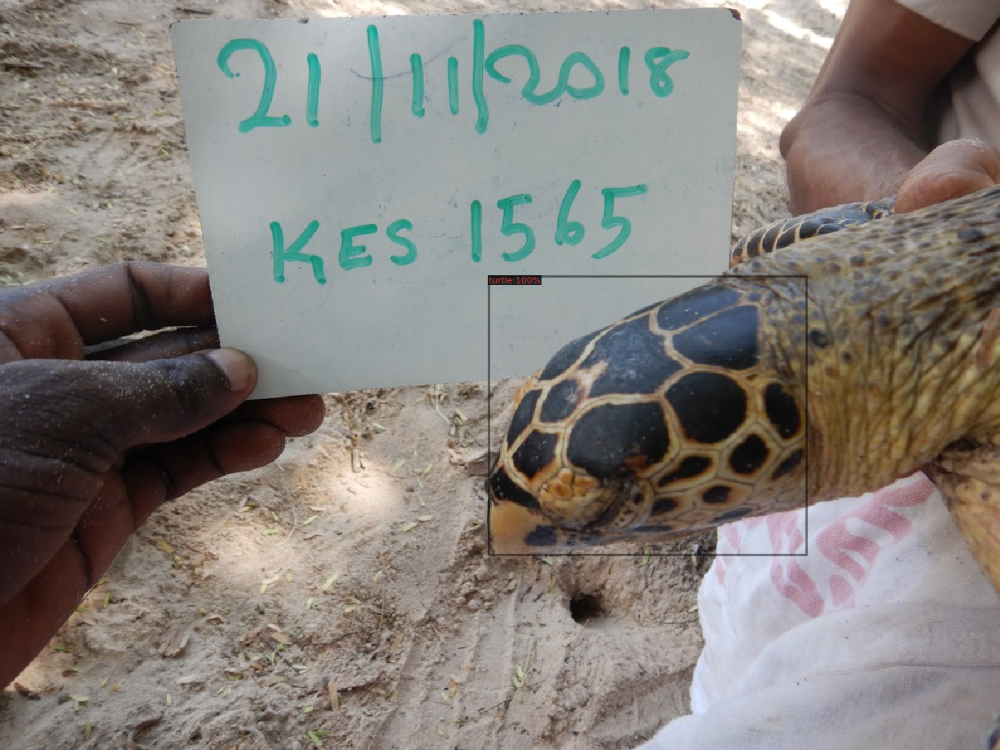

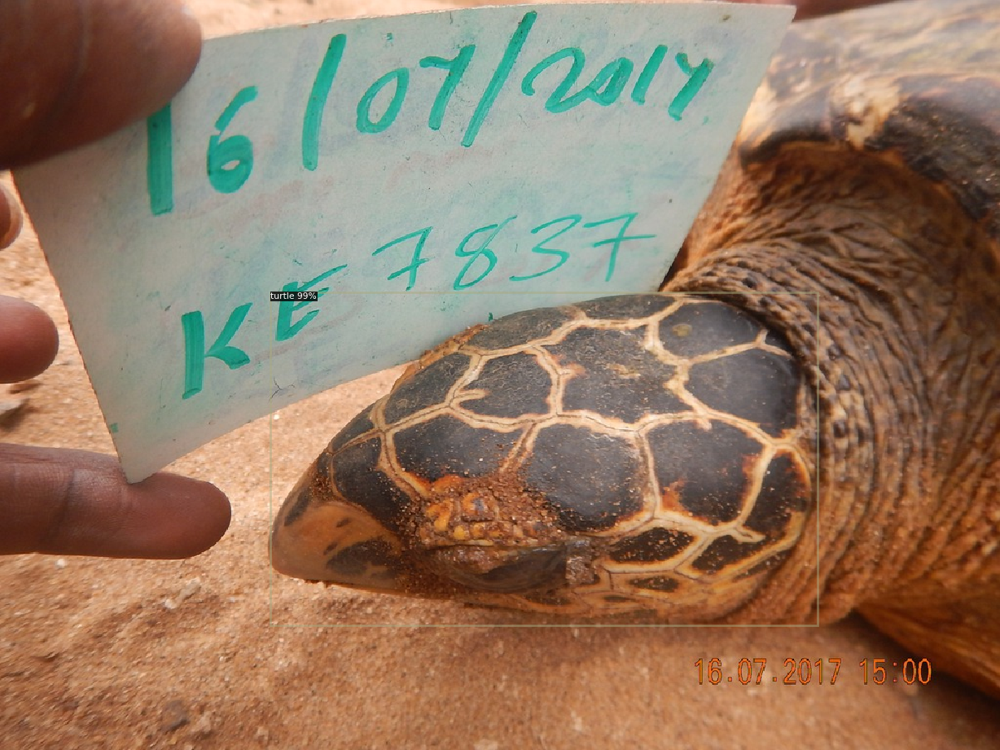

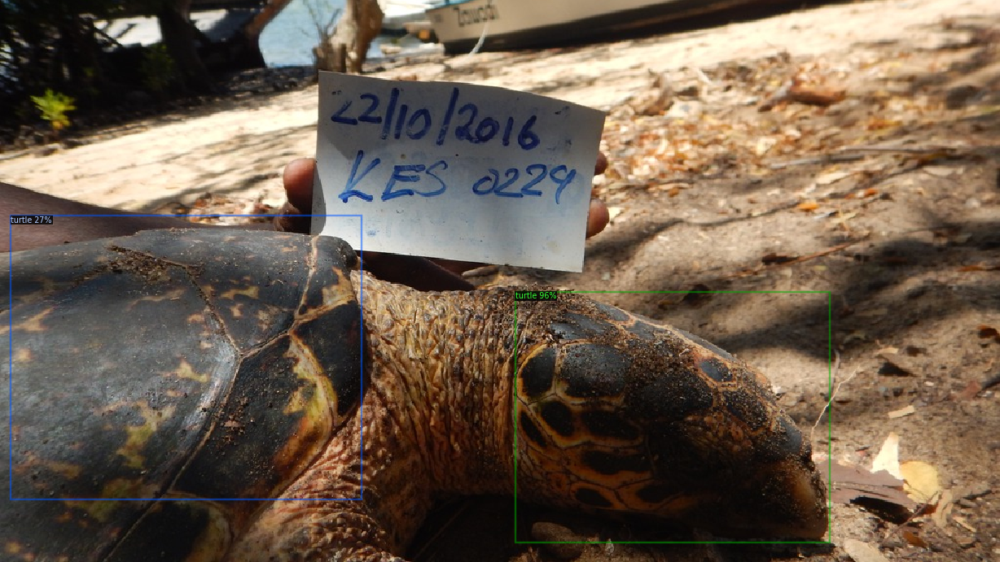

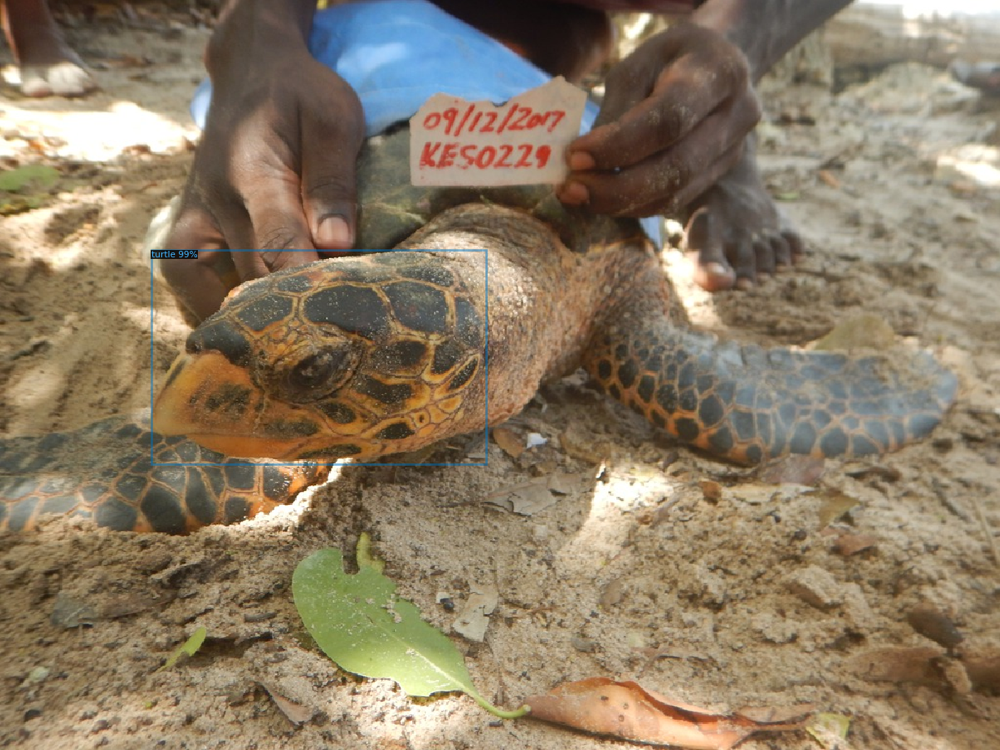

In [31]:
for img in sampled_good_imgs:
    im = cv2.imread(f"/content/turtles_data/IMAGES_1024/{img}.JPG")
    outputs = predictor(im)
    oi = visualize_predictions(im, outputs, cfg)
    cv2_imshow(oi)